# 👋 Welcome to the **PyTorch** tutorial


In this tutorial, we will see how we can use Feature Attribution methods when you have a PyTorch model. Even though Xplique is built for Tensorflow (TF), we can still use most attributions methods for common PyTorch classifier:

<a name="available_methods"></a>

| **Attribution Method** | PyTorch compatible |
| :--------------------- | :----------------: |
| Deconvolution          | ❌                |
| Grad-CAM               | ❌                |
| Grad-CAM++             | ❌                |
| Gradient Input         | ✅                |
| Guided Backprop        | ❌                |
| Integrated Gradients   | ✅                |
| Kernel SHAP            | ✅                |
| Lime                   | ✅                |
| Occlusion              | ✅                |
| Rise                   | ✅                |
| Saliency               | ✅                |
| SmoothGrad             | ✅                |
| SquareGrad             | ✅                |
| VarGrad                | ✅                |
| Sobol Attribution      | ✅                |
| Hsic Attribution       | ✅                |

In this tutorial we will reproduce the results of the [**Attribution Methods**: Getting started](https://colab.research.google.com/drive/1XproaVxXjO9nrBSyyy7BuKJ1vy21iHs2) <sub> [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1XproaVxXjO9nrBSyyy7BuKJ1vy21iHs2) </sub> tutorial but we will replace the [TF's MobileNetV2](https://www.tensorflow.org/api_docs/python/tf/keras/applications/mobilenet_v2/MobileNetV2) model with the [PyTorch's MobileNetV2](https://pytorch.org/hub/pytorch_vision_mobilenet_v2/)!

✏️ Author: Lucas HERVIER

✉️ lucas.hervier@irt-saintexupery.com

<p align="center">
  <img src="https://github.com/deel-ai/xplique/blob/master/docs/assets/banner.png?raw=true"/>
</p>



- 📘 <a href="https://deel-ai.github.io/xplique"> Documentation </a>
- <img src="https://github.githubassets.com/images/icons/emoji/octocat.png" width=20> <a href="https://github.com/deel-ai/xplique"> Github </a>
- 🦊 <a href="https://github.com/deel-ai/xplique/blob/master/TUTORIALS.md"> More Xplique tutorials </a>

# ⚙️ Installing **Xplique** and utils

In [ ]:
# !pip install -q xplique
!pip install -q git+https://github.com/deel-ai/xplique.git@lucas/torch

  Preparing metadata (setup.py) ... done


In [ ]:
import os
from math import ceil
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import cv2

import tensorflow as tf
import torch
import torch.nn as nn
from torchvision import transforms

%matplotlib inline
%config InlineBackend.figure_format='retina'

import xplique
from xplique.wrappers import TorchWrapper
from xplique.plots import plot_attributions

In [ ]:
tf.config.run_functions_eagerly(True)

# 🦊 Download and preprocess some images

2023-08-25 08:24:52 URL:https://images.unsplash.com/photo-1615602127413-459bdb48cf45?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=phil-plante-X2PwqTUpXH8-unsplash.jpg&w=640 [79577/79577] -> "fox1.jpg" [1]
2023-08-25 08:24:53 URL:https://images.unsplash.com/photo-1516934024742-b461fba47600?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=sunguk-kim-tIfrzHxhPYQ-unsplash.jpg&w=640 [101689/101689] -> "fox2.jpg" [1]
2023-08-25 08:24:53 URL:https://images.unsplash.com/photo-1496196614460-48988a57fccf?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=randall-ruiz-LVnJlyfa7Zk-unsplash.jpg&w=640 [106140/106140] -> "sea_turtle.jpg" [1]
2023-08-25 08:24:53 URL:https://images.unsplash.com/photo-1552833172-fd5ac167c18c?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=zdenek-machacek-sSEEbAzB6fU-unsplash.jpg&w=640 [113528/113528] -> "lynx.jpg" [1]
2023-08-25 08:24:54 URL:https://images.unsplash.com/photo-1616588945355-bb09c77baf29?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=sandra-

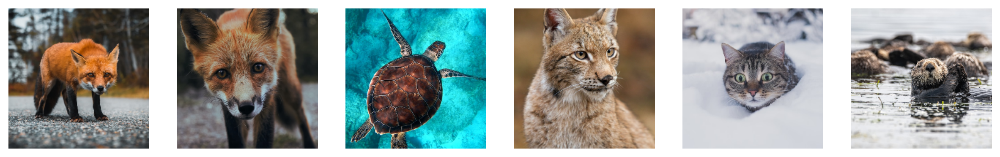

In [ ]:
# downloading image from unsplash...
!wget -nv 'https://unsplash.com/photos/X2PwqTUpXH8/download?force=true&w=640' -O 'fox1.jpg'
!wget -nv 'https://unsplash.com/photos/tIfrzHxhPYQ/download?force=true&w=640' -O 'fox2.jpg'
!wget -nv 'https://unsplash.com/photos/LVnJlyfa7Zk/download?force=true&w=640' -O 'sea_turtle.jpg'
!wget -nv 'https://unsplash.com/photos/sSEEbAzB6fU/download?force=true&w=640' -O 'lynx.jpg'
!wget -nv 'https://unsplash.com/photos/41dAczoRYJY/download?force=true&w=640' -O 'cat.jpg'
!wget -nv 'https://unsplash.com/photos/axqTLZ12Jss/download?force=true&w=640' -O 'otter.jpg'

img_list = [
    ('fox1.jpg', 277),
    ('fox2.jpg', 277),
    ('sea_turtle.jpg', 33),
    ('lynx.jpg', 287),
    ('cat.jpg', 281),
    ('otter.jpg', 360)
]

def central_crop_and_resize(img, size=224):
  """
  Given a numpy array, extracts the largest possible square and resizes it to
  the requested size
  """
  h, w, _ = img.shape

  min_side = min(h, w)
  max_side_center = max(h, w) // 2.0

  min_cut = int(max_side_center-min_side//2)
  max_cut = int(max_side_center+min_side//2)

  img = img[:, min_cut:max_cut] if w > h else img[min_cut:max_cut]
  img = tf.image.resize(img, (size, size))

  return img

X = []
Y = []

for img_name, label in img_list:
    img = cv2.imread(img_name)[..., ::-1] # when cv2 load an image, the channels are inversed
    img = central_crop_and_resize(img)
    label = tf.keras.utils.to_categorical(label, 1000)

    X.append(img)
    Y.append(label)

# X = np.array(X, dtype=np.float32) # in the Getting Started tutorial
X = np.array(X, dtype=np.uint8) # slight change here
Y = np.array(Y)

plt.rcParams["figure.figsize"] = [15, 6]
for img_id, img in enumerate(X):
  plt.subplot(1, len(X), img_id+1)
  plt.imshow(img)
  # plt.imshow(img/255.0) # as img is now a uint8 that is not necessary
  plt.axis('off')

❓ **What is different** ❓

Up to that point, there is one slight difference between the TF vs. PyTorch approach:

- We did not convert the image array to `np.float32` but to `np.uint8` instead

That simple difference is explained by how the preprocessing functions in TF vs. PyTorch expect their inputs.

# 📥 Load a pretrained PyTorch model

In [ ]:
# load the PyTorch MobilNetV2 model trained on ImageNet
model = torch.hub.load('pytorch/vision:v0.10.0', 'mobilenet_v2', pretrained=True, verbose=False)
model.eval()

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 64.3MB/s]


MobileNetV2(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(96, eps=

In [ ]:
# add the preprocessing function, as resizing and cropping is already applied
# we do not add them in the compose
preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

X_preprocessed = torch.stack([preprocess(x) for x in X])

In [ ]:
# make prediction
with torch.no_grad():
    output = model(X_preprocessed)

probabilities = torch.nn.functional.softmax(output, dim=1)

--2023-08-25 08:24:59--  https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10472 (10K) [text/plain]
Saving to: ‘imagenet_classes.txt’

imagenet_classes.tx 100%[===================>]  10.23K  --.-KB/s    in 0s      

2023-08-25 08:24:59 (119 MB/s) - ‘imagenet_classes.txt’ saved [10472/10472]



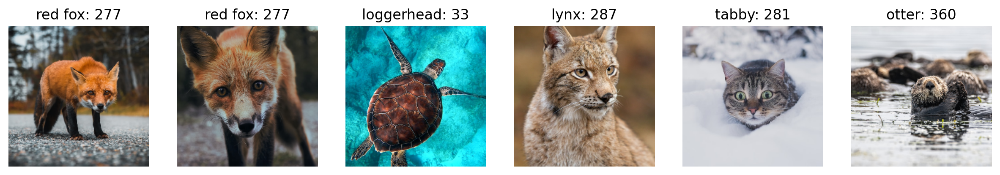

In [ ]:
# Download ImageNet labels
!wget https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt

# Read the categories
with open("imagenet_classes.txt", "r") as f:
    classes = [s.strip() for s in f.readlines()]
# Get label prediction for each image
preds = torch.argmax(probabilities, dim=1)
preds = preds.detach().numpy()
preds_labels = np.array([classes[pred] for pred in preds])

# Assert the predictions are right
for img_id, img in enumerate(X):
  plt.subplot(1, len(X), img_id+1)
  plt.title(f"{preds_labels[img_id]}: {preds[img_id]}")
  plt.imshow(img)
  plt.axis('off')

# ✨ Generate explanations for multiple attribution methods

As in the [**Attribution Methods**: Getting started](https://colab.research.google.com/drive/1XproaVxXjO9nrBSyyy7BuKJ1vy21iHs2) notebook we will generate explanations for several methods but this time with our PyTorch model!

In [ ]:
from xplique.attributions import (Saliency, GradientInput, IntegratedGradients, SmoothGrad, VarGrad,
                                  SquareGrad, Occlusion, Rise, GuidedBackprop, Lime, KernelShap, SobolAttributionMethod)

## Wrap the Pytorch model

In [ ]:
# wrap the torch model
device = 'cuda' if torch.cuda.is_available() else 'cpu'
wrapped_model = TorchWrapper(model, device)

/usr/local/lib/python3.10/dist-packages/xplique/wrappers/pytorch.py:56: UserWarning: TF is set to run eagerly to avoid conflict with Pytorch. Thus,                       TF functions might be slower
  warnings.warn("TF is set to run eagerly to avoid conflict with Pytorch. Thus,\


## Match the input shape to TF's convention

In [ ]:
# modify inputs to match explainers expectations
X_preprocessed4explainer = np.moveaxis(X_preprocessed.numpy(), [1, 2, 3], [3, 1, 2])

## Explain your inputs!

/usr/local/lib/python3.10/dist-packages/xplique/wrappers/pytorch.py:136: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ../torch/csrc/utils/tensor_numpy.cpp:206.)
  torch_inputs = self.torch.Tensor(np_inputs)


Method: Saliency


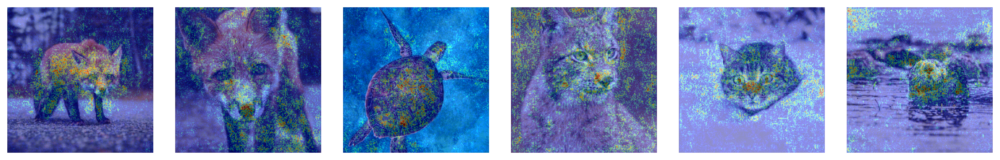



Method: GradientInput


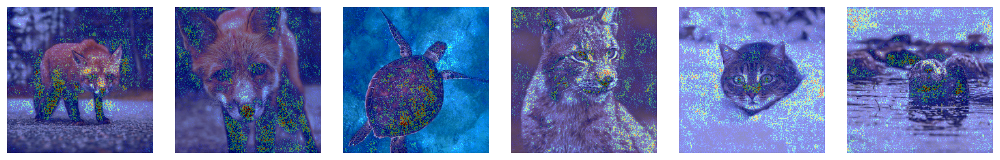



Method: IntegratedGradients


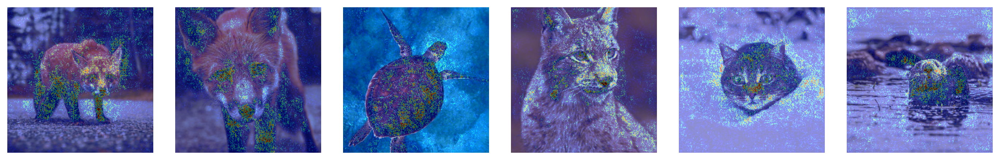



Method: SmoothGrad


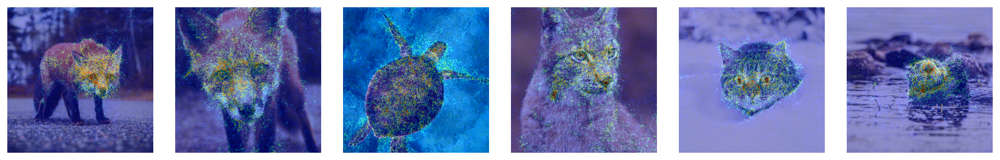



Method: SquareGrad


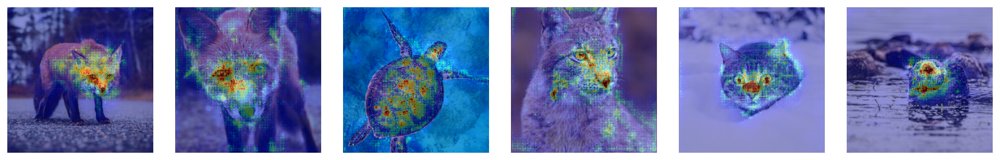



Method: VarGrad


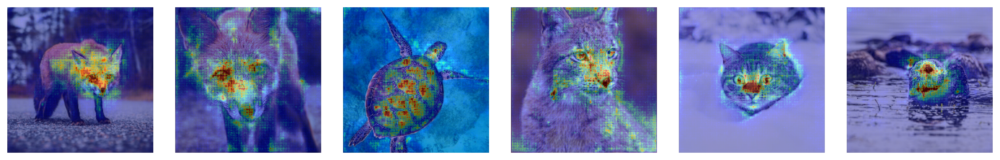



Method: Occlusion


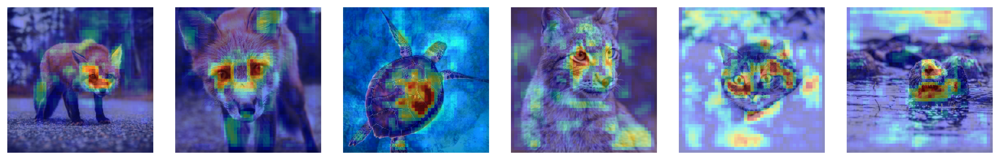



Method: Rise


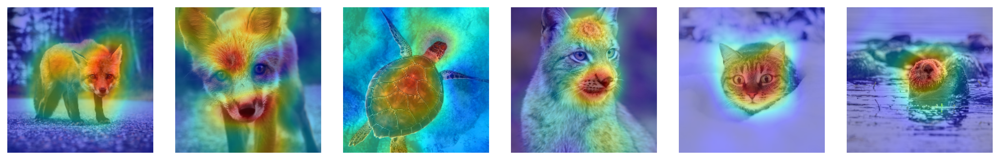



Method: SobolAttributionMethod


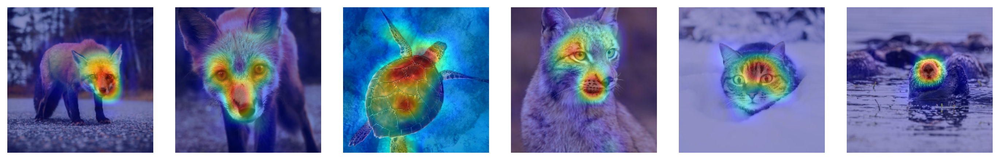

In [ ]:
# set batch size parameter
batch_size = 64

# build the explainers
explainers = [
             Saliency(wrapped_model),
             GradientInput(wrapped_model),
             IntegratedGradients(wrapped_model, steps=80, batch_size=batch_size),
             SmoothGrad(wrapped_model, nb_samples=80, batch_size=batch_size),
             SquareGrad(wrapped_model, nb_samples=80, batch_size=batch_size),
             VarGrad(wrapped_model, nb_samples=80, batch_size=batch_size),
             Occlusion(wrapped_model, patch_size=10, patch_stride=5, batch_size=batch_size),
             Rise(wrapped_model, nb_samples=4000, batch_size=batch_size),
             SobolAttributionMethod(wrapped_model, batch_size=batch_size),
            #  Lime(wrapped_model, nb_samples = 4000, batch_size=batch_size),
            #  KernelShap(wrapped_model, nb_samples = 4000, batch_size=batch_size)
]

for explainer in explainers:

  explanations = explainer(X_preprocessed4explainer, Y)

  print(f"Method: {explainer.__class__.__name__}")
  plot_attributions(explanations, X, img_size=2., cmap='jet', alpha=0.4,
                    cols=len(X), absolute_value=True, clip_percentile=0.5)
  plt.show()
  print("\n")

# 🎉 Congratulations
**You have just learned how to wrap a Pytorch's model and making it work with Xplique!**

Curious about how to use the different metrics with a PyTorch model ? Then, follow the [**Metrics**: For Pytorch](https://colab.research.google.com/drive/16bEmYXzLEkUWLRInPU17QsodAIbjdhGP) <sub> [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/16bEmYXzLEkUWLRInPU17QsodAIbjdhGP) </sub>

PS: Notice how with two additional little steps it works! More details in the [additional section](#how-is-my-pytorch-classifier-wrapped-to-work-with-xplique) or in the [Pytorch Wrapper documentation]()

# 🎁 How is my PyTorch classifier wrapped to work with **Xplique** ?



As we explained, **Xplique** is a Tensorflow toolbox. It was designed, built, and optimized with that consideration. However, most of the attribution methods can be applied (see the [Table](#available_methods) at the beginning of the notebook) on PyTorch's most common classifiers (i.e. the pre-trained models on ImageNet) with a simple wrapper:

```python
class TorchWrapper(tf.keras.Model):
    """
    A wrapper for PyTorch's model so that they can be used in Xplique framework
    for most attributions method

    Parameters
    ----------
    torch_model
        A nn.Module PyTorch model
    device
        If we are on GPU or CPU
    is_channel_first
        A boolean that is true if the torch's model expect a channel dim and if this one come first
    """

    def __init__(self, torch_model: "nn.Module", device: Union['torch.device', str],
                 is_channel_first: Optional[bool] = None
                 ): # pylint: disable=C0415,C0103

        super().__init__()

        try:
            # use PyTorch functionality
            import torch
            from torch import nn
            from torch import from_numpy
            self.torch = torch
            self.nn = nn
            self.from_numpy = from_numpy
        except ImportError as exc:
            raise ImportError(
            "PyTorch is required to use this feature. \
             Please install PyTorch using 'pip install torch'."
            ) from exc

        assert not(torch_model.training), "Please provide a torch module in eval mode"
        self.model = torch_model.to(device)
        self.device = device
        # with torch, the convention for CNN is (N, C, H, W)
        if is_channel_first is None:
            self.channel_first = self._has_conv_layers()
        else:
            self.channel_first = is_channel_first
        # deactivate all tf.function
        tf.config.run_functions_eagerly(True)
        warnings.warn("TF is set to run eagerly to avoid conflict with Pytorch. Thus,\
                       TF functions might be slower")

    # pylint: disable=arguments-differ
    @tf.custom_gradient
    def call(self, inputs: np.ndarray) -> Tuple[tf.Tensor, Callable]:
        """
        A method that allow to call the PyTorch model wrapped on inputs that are
        numpy arrays reshaped to match Xplique's explainers expectations (i.e. channel-last)
        , get the gradients from PyTorch framework and recast outputs and gradients
        as Tensorflow tensors.

        Parameters
        ----------
        inputs
            Processed inputs as numpy arrays

        Returns
        -------
        outputs
            Outputs of the PyTorch model converted to Tensorflow tensor
        grad
            The function that allow to compute the gradient of the PyTorch model and
            broadcast it for Tensorflow
        """
        # transform your numpy inputs to torch
        torch_inputs = self.np_img_to_torch(inputs).to(self.device)
        torch_inputs.requires_grad_(True)

        # make predictions
        self.model.zero_grad()
        outputs = self.model(torch_inputs)
        output_tensor = tf.constant(outputs.cpu().detach().numpy())

        def grad(upstream):
            self.torch.autograd.backward(
                outputs,
                grad_tensors=self.from_numpy(upstream.numpy()).to(self.device),
                retain_graph=False
            )
            dx_torch = torch_inputs.grad

            dx_np = dx_torch.cpu().detach().numpy()
            if self.channel_first:
                # (N, C, H, W) -> (N, H, W, C) for explainer
                dx_np = np.moveaxis(dx_np, [1, 2, 3], [3, 1, 2])

            gradient = tf.constant(dx_np)
            return gradient

        return output_tensor, grad

    def np_img_to_torch(self, np_inputs: np.ndarray):
        """
        Methods that transform inputs as expected by the explainer to inputs expected
        by your PyTorch model.

        Notes
        -----
        If your model (or your data pipeline) has more specifities, change this function to make
        the bridge

        Parameters
        ----------
        np_inputs
            Inputs as numpy arrays (simpler for conversion between PyTorch
            and Tensorflow)

        Returns
        -------
        torch_inputs
            Torch Tensor with the format expected by the PyTorch model
        """
        if self.channel_first:
            # go from channel last to channel first for the torch model
            np_inputs = np.moveaxis(np_inputs, [3, 1, 2], [1, 2, 3])
        else:
            np_inputs = np.asarray(np_inputs)

        # convert numpy array to torch tensor
        torch_inputs = self.torch.Tensor(np_inputs)

        return torch_inputs

    def _has_conv_layers(self):
        """
        A method that checks if the PyTorch's model has 2D convolutional layer.
        Indeed, convolution with PyTorch expects inputs in the shape (N, C, H, W)
        where TF expect (N, H, W, C).

        Returns
        -------
        has_conv_layers
            A boolean that says if the PyTorch model has Conv2d layers
        """
        has_conv_layers = False

        for module in self.model.modules():
            if isinstance(module, self.nn.Conv2d):
                has_conv_layers = True
                break

        return has_conv_layers
```

❓ **What does it do** ❓

As we pointed out earlier, most PyTorch's model expect images to be channel first while in Tensorflow, images tend to be channel last. Consequently, explainer objects also expect images to be channel last. Thus, when we will ask a given explainer to explain inputs we will have to give them with channel last. If your processing yields inputs with the channel first, we must move the channel axis to the last dimension to match the explainer's expectation. However, when we will want to call the underlying model this will lead to a mismatch as it expects channel-first images! That is why we define in the wrapper the `np_img_to_torch` method: this method handles the mismatch between the expectation of the explainer and the ones of the PyTorch model.

For any Black-box attribution method that would be all as they do not necessitate gradient computation and we could simply define the simpler template below. However, for the White-box attribution methods we need to get the gradients from PyTorch and to provide it to Tensorflow. Consequently, we use the decorator `@tf.custom_gradient` to specify to Tensorflow that it won't need to compute the gradient as we will provide the gradient function for him. In order to do so, we simply use the gradient functionality of PyTorch, reshape the gradients (as the inputs are channel-first so are the gradients) and cast them to tensorflow tensor.

```python
class SimplerTorchWrapper(tf.keras.Model):
    """
    A wrapper for PyTorch's model so that they can be used in Xplique framework
    for most attributions method

    Parameters
    ----------
    torch_model
        A nn.Module PyTorch model
    device
        If we are on GPU or CPU
    is_channel_first
        A boolean that is true if the torch's model expect a channel dim and if this one come first
    """

    def __init__(self, torch_model: nn.Module, device: Union['torch.device', str],
                 is_channel_first: Optional[bool] = None):
        super().__init__()
        self.model = torch_model.to(device)
        self.device = device
        # with torch, the convention for CNN is (N, C, H, W)
        if is_channel_first is None:
            self.channel_first = self._check_conv_layers()
        else:
            self.channel_first = is_channel_first
        # deactivate all tf.function
        tf.config.run_functions_eagerly(True)

    # pylint: disable=arguments-differ
    def call(self, inputs: np.ndarray) -> Tuple[tf.Tensor, Callable]:
        """
        A method that allow to call the PyTorch model wrapped on inputs that are
        numpy arrays reshaped to match Xplique's explainers expectations (i.e. channel-last)
        , get the gradients from PyTorch framework and recast outputs and gradients
        as Tensorflow tensors.

        Parameters
        ----------
        inputs
            Processed inputs as numpy arrays
        
        Returns
        -------
        outputs
            Outputs of the PyTorch model converted to Tensorflow tensor
        grad
            The function that allow to compute the gradient of the PyTorch model and
            broadcast it for Tensorflow
        """
        # transform your numpy inputs to torch
        torch_inputs = self.transform_np_inputs(inputs).to(self.device)
        torch_inputs.requires_grad_(True)

        # make predictions
        self.model.zero_grad()
        outputs = self.model(torch_inputs)
        output_tensor = tf.constant(outputs.cpu().detach().numpy())

        return output_tensor

    def transform_np_inputs(self, np_inputs: np.ndarray):
        """
        Methods that transform inputs as expected by the explainer to inputs expected
        by your PyTorch model.

        Notes
        -----
        If your model (or your data pipeline) has more specifities, change this function to make
        the bridge

        Parameters
        ----------
        np_inputs
            Inputs as numpy arrays (simpler for conversion between PyTorch
            and Tensorflow)

        Returns
        -------
        torch_inputs
            Torch Tensor with the format expected by the PyTorch model
        """
        if self.channel_first:
            # go from channel last to channel first for the torch model
            np_inputs = np.moveaxis(np_inputs, [3, 1, 2], [1, 2, 3])
        else:
            np_inputs = np.asarray(np_inputs)

        # convert numpy array to torch tensor
        torch_inputs = torch.Tensor(np_inputs)

        return torch_inputs

    def _check_conv_layers(self):
        """
        A method that checks if the PyTorch's model has 2D convolutional layer.
        Indeed, convolution with PyTorch expects inputs in the shape (N, C, H, W)
        where TF expect (N, H, W, C).

        Returns
        -------
        has_conv_layers
            A boolean that says if the PyTorch model has Conv2d layers
        """
        has_conv_layers = False

        for module in self.model.modules():
            if isinstance(module, nn.Conv2d):
                has_conv_layers = True
                break

        return has_conv_layers
  ```